In [7]:
 # Imports 
import pandas as pd
import geopandas as gpd
from shapely import wkt,Point
import contextily as ctx
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
import numpy as np
from geopy.distance import geodesic
from pykalman import KalmanFilter
from sklearn.cluster import DBSCAN

from fastapi import FastAPI, UploadFile, File, HTTPException
from pydantic import BaseModel
from typing import List, Optional
import uvicorn
import nest_asyncio
import threading

from datetime import datetime
import io
import os
import requests

# Data Imporation and Exploration

### Exploratory Visualization of GPS Traces

In this section, we visually explore the spatial distribution of GPS trace points to better understand vehicle movement patterns. Each trace is plotted individually, with points colored according to their local spatial density.

The density is computed using **Gaussian Kernel Density Estimation (KDE)**, which estimates how concentrated the points are in a given area. This density is then normalized on a scale from 0 to 1 to ensure consistent visualization across traces.

The resulting scatterplot uses a **heatmap-style color scheme**, where warmer colors (e.g., yellow, red) indicate areas of higher point density, while cooler or darker regions indicate lower density.

#### Why this visualization is useful:

- **High-density areas** generally suggest slower movement or stationary periods, such as stops or traffic congestion.
- **Low-density areas** typically correspond to faster movement with fewer recorded points in between.

This approach helps highlight **spatial behavior patterns** even before applying any clustering or stop detection algorithms.


In [8]:

# Load the raw GPS traces CSV.
df = pd.read_csv('gps_traces.csv')

# Convert the timestamp to datetime.
df['ts'] = pd.to_datetime(df['ts'])

# Convert geom_wkt to geometry objects.
df['geometry'] = df['geom_wkt'].apply(wkt.loads)

# Build a GeoDataFrame.
gdf = gpd.GeoDataFrame(df, geometry='geometry', crs='EPSG:4326')

# Sort the data by device, trace, and timestamp.
gdf = gdf.sort_values(['device_id', 'trace_number', 'ts']).reset_index(drop=True)

# Extract latitude and longitude.
gdf['latitude'] = gdf.geometry.apply(lambda geom: geom.y)
gdf['longitude'] = gdf.geometry.apply(lambda geom: geom.x)

# Display Head
gdf.head()


,geom_wkt,trace_number,device_id,ts,geometry,latitude,longitude
0,POINT (116.590957 40.071961),2,0,2009-06-29 07:02:25+00:00,POINT (116.59096 40.07196),40.071961,116.590957
1,POINT (116.590905 40.072007),2,0,2009-06-29 07:02:30+00:00,POINT (116.5909 40.07201),40.072007,116.590905
2,POINT (116.590879 40.072027),2,0,2009-06-29 07:02:35+00:00,POINT (116.59088 40.07203),40.072027,116.590879
3,POINT (116.590915 40.072004),2,0,2009-06-29 07:02:40+00:00,POINT (116.59092 40.072),40.072004,116.590915
4,POINT (116.590961 40.071983),2,0,2009-06-29 07:02:45+00:00,POINT (116.59096 40.07198),40.071983,116.590961


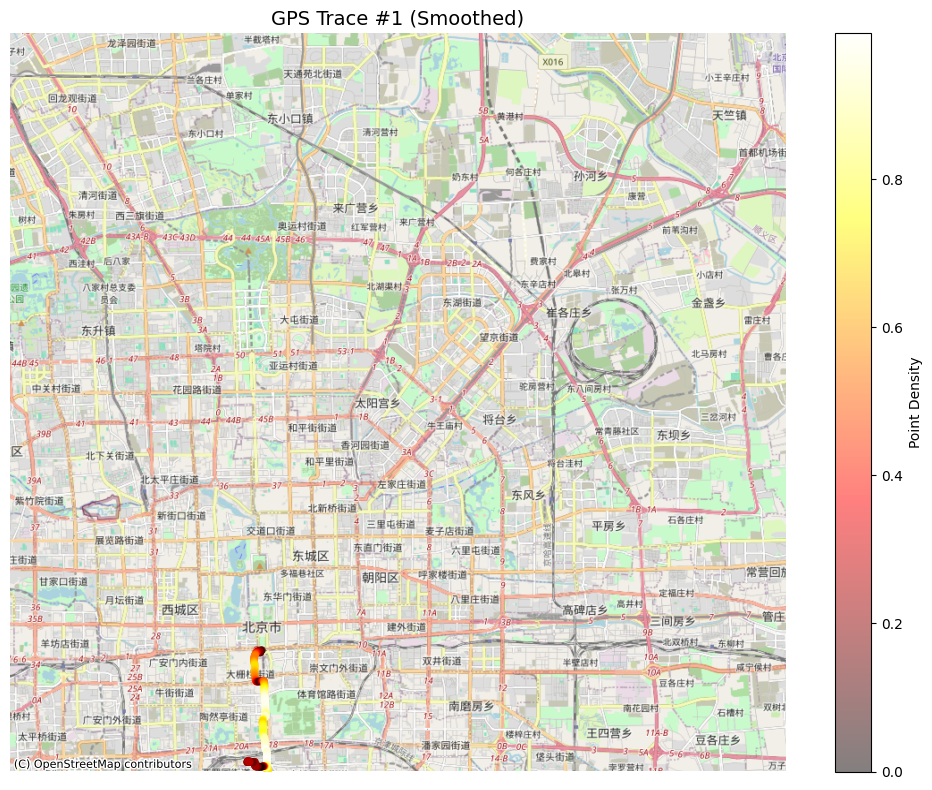

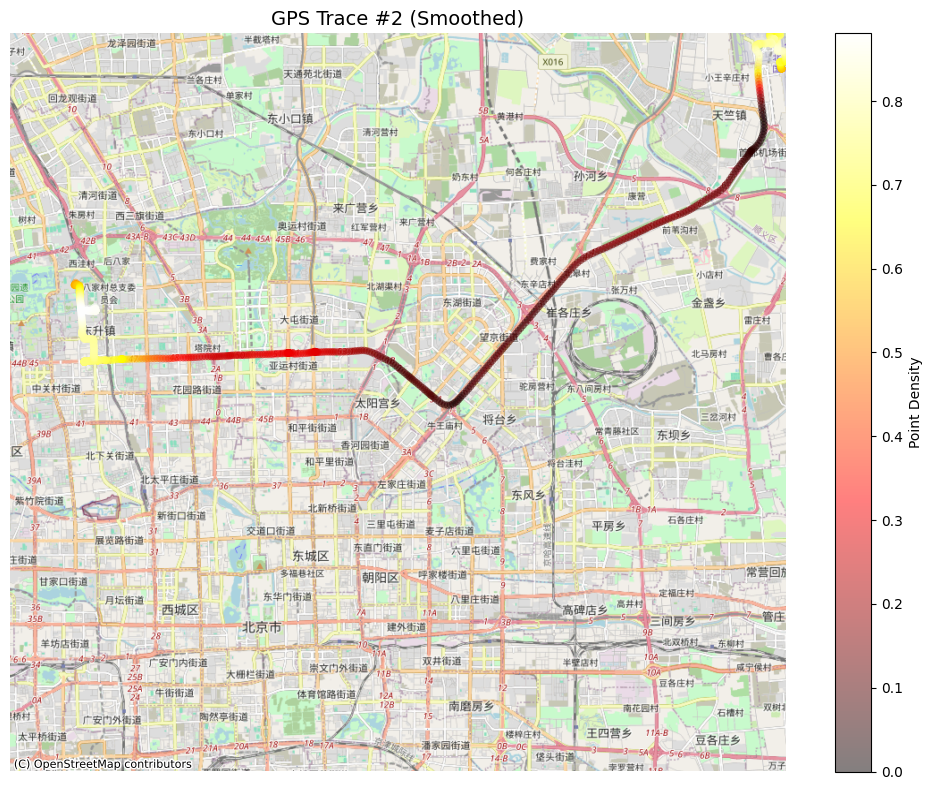

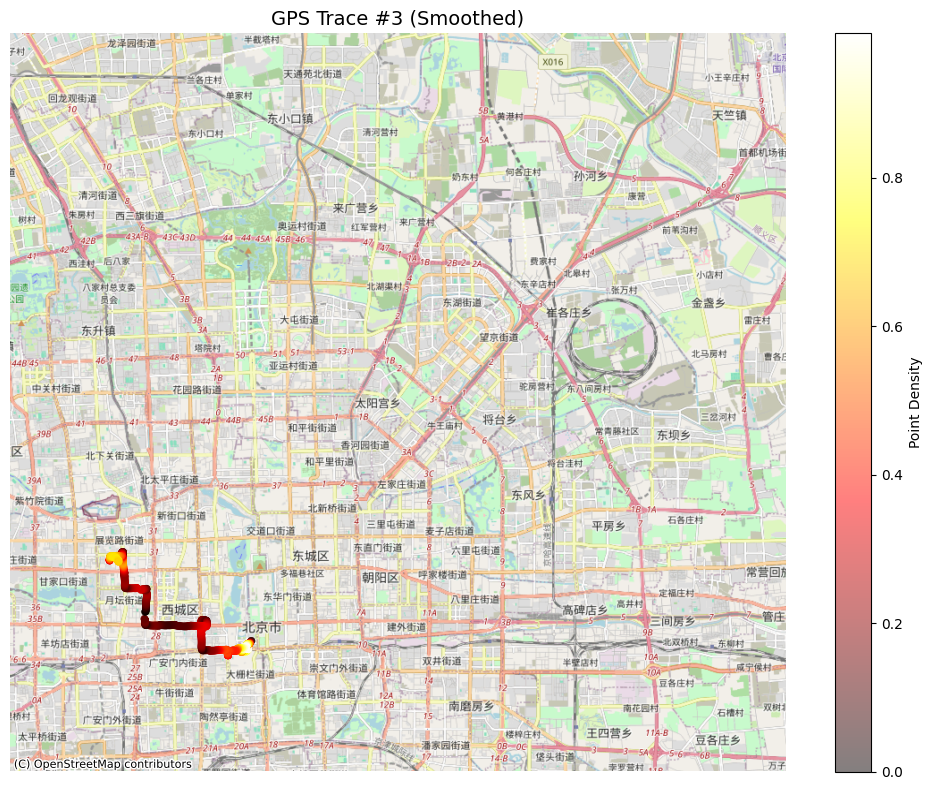

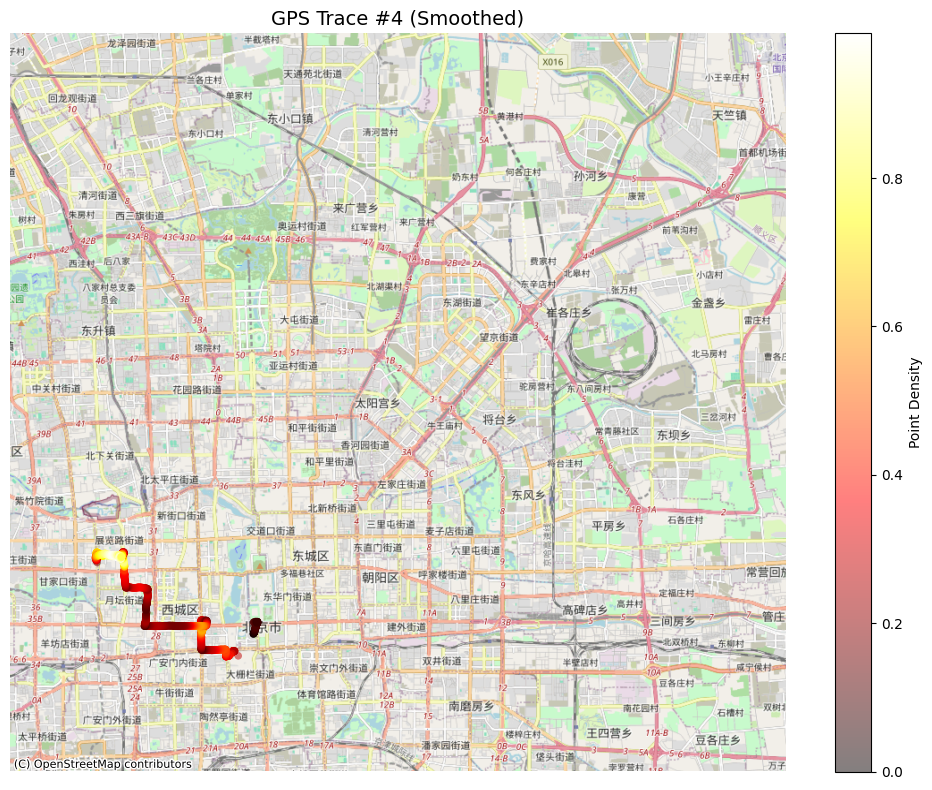

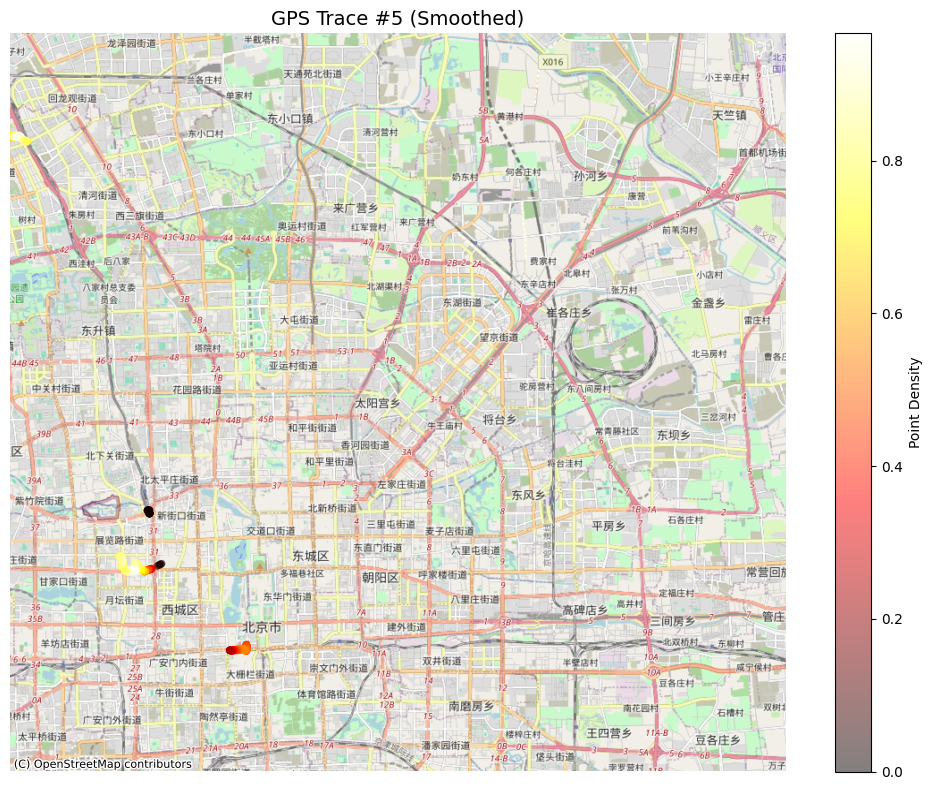

In [9]:


# Project to Web Mercator for basemap usage:
gdf_w = gdf.to_crs(epsg=3857)

# Calculate overall bounds once (for consistent map extent across all plots)
minx, miny, maxx, maxy = gdf_w.total_bounds

# Group by trace_number and plot each trace on its own figure.
for trace_number, group in gdf_w.groupby('trace_number'):
    fig, ax = plt.subplots(figsize=(10, 8))
    
    # Extract x and y coordinates from the updated geometry (the smoothed coordinates).
    x = group.geometry.x
    y = group.geometry.y

    # Compute point density with Gaussian KDE.
    xy = np.vstack([x, y])
    density = gaussian_kde(xy)(xy)

    # Normalize density for this trace.
    dmin_local = density.min()
    dmax_local = density.max()
    density_norm = (density - dmin_local) / (dmax_local - dmin_local + 1e-9)
    
    # Scatter-plot with points colored by density.
    scatter = ax.scatter(
        x, 
        y,
        c=density_norm,
        cmap='hot',
        s=30,
        alpha=0.5,
        edgecolor='none'
    )
    
    # Use consistent axis limits based on overall bounds.
    ax.set_xlim(minx, maxx)
    ax.set_ylim(miny, maxy)
    
    # Add basemap.
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
    
    # Title and clean up the axes.
    ax.set_title(f'GPS Trace #{trace_number} (Smoothed)', fontsize=14)
    ax.set_axis_off()

    # Optional: add colorbar for density.
    cbar = plt.colorbar(scatter, ax=ax)
    cbar.set_label('Point Density', rotation=90)
    
    plt.tight_layout()
    plt.show()


Trace 5 appears to be very sparse, with GPS points scattered and limited in number. The low density and irregular spacing between points suggest that this trace does not capture fluid or continuous movement.

As a result, it's difficult to infer meaningful motion patterns or detect stops from this trace. This could be due to:

Infrequent GPS sampling,

Signal loss or missing data,

Or the vehicle being mostly stationary during the recording period.

Such traces may require special handling or exclusion in downstream analyses.

# Feature Engeneering

### Feature Engineering: Enriching GPS Data with Movement Metrics

To prepare the GPS data for downstream tasks such as stop detection or trajectory analysis, we extract a series of spatial and temporal features for each point.

#### Key Features Computed:

- **Smoothed Coordinates**: Optionally apply a Kalman filter to reduce GPS noise and improve trajectory continuity.
- **Distance**: Geodesic distance (in meters) between consecutive points.
- **Time Difference**: Time gap (in seconds) between each point and its predecessor.
- **Speed**: Instantaneous speed calculated as distance over time.
- **Acceleration**: Change in speed over time, providing insights into vehicle behavior (e.g., braking, accelerating).

The processing is applied trace-by-trace and device-by-device to ensure consistency and to avoid data leakage across trajectories. This enriched GeoDataFrame serves as a robust foundation for both rule-based and machine learning-based stop detection methods.


In [10]:

def compute_gps_features(gdf, use_smoothing=True):
    """
    Compute spatial and temporal features for a GeoDataFrame of GPS traces.
    
    If use_smoothing is True, the function computes smoothed coordinates using a Kalman filter
    (if they do not already exist) and uses those for computing features. If False, it uses the 
    raw coordinates.
    
    This function assumes that the input GeoDataFrame 'gdf' contains at least:
      - 'ts': Timestamps (as datetime objects)
      - 'longitude', 'latitude': Raw coordinates (in degrees)
      - 'device_id': Identifier for the GPS device
      - 'trace_number': Identifier for the specific trace or journey
      
    It computes the following features:
      - 'smooth_lon', 'smooth_lat': Smoothed coordinates (if use_smoothing=True, computed via Kalman filter; 
         otherwise, set equal to raw coordinates).
      - 'prev_smooth_lon', 'prev_smooth_lat': The smoothed coordinates of the previous point 
         (or raw, if not smoothing) within each device and trace.
      - 'prev_ts': The previous timestamp.
      - 'distance_m': The geodesic distance (in meters) between consecutive points (using the chosen coordinates).
      - 'time_diff_s': The time difference (in seconds) between consecutive points.
      - 'speed_m_s': The instantaneous speed in meters per second.
      - 'prev_speed': The speed from the previous point.
      - 'acceleration_m_s2': The instantaneous acceleration in m/s².
    
    Parameters:
      gdf (GeoDataFrame): Input GeoDataFrame with GPS data.
      use_smoothing (bool): If True, compute and use smoothed coordinates. Default is True.
      
    Returns:
      GeoDataFrame: A new GeoDataFrame with additional computed feature columns.
    """
    # Work on a copy to avoid modifying the original DataFrame.
    gdf = gdf.copy()
    
    # Compute smoothed coordinates
    if use_smoothing:
        # Check if the smoothed coordinate columns exist; if not, compute them.
        if not all(col in gdf.columns for col in ['smooth_lon', 'smooth_lat']):
            # Use the raw geometry values to build an array of [lon, lat] pairs.
            coords = np.vstack(gdf.geometry.apply(lambda geom: [geom.x, geom.y]))
            # Initialize the Kalman filter with the first coordinate as the initial state.
            kf = KalmanFilter(initial_state_mean=coords[0], n_dim_obs=2)
            smoothed_coords, _ = kf.smooth(coords)
            # Create new columns for smoothed longitude and latitude.
            gdf['smooth_lon'] = smoothed_coords[:, 0]
            gdf['smooth_lat'] = smoothed_coords[:, 1]
    else:
        # If not smoothing, set the smoothed columns equal to the raw coordinates.
        gdf['smooth_lon'] = gdf['longitude']
        gdf['smooth_lat'] = gdf['latitude']
    
    # Compute previous coordinates and timestamps (grouped by device_id and trace_number)
    gdf['prev_smooth_lon'] = gdf.groupby(['device_id', 'trace_number'])['smooth_lon'].shift(1)
    gdf['prev_smooth_lat'] = gdf.groupby(['device_id', 'trace_number'])['smooth_lat'].shift(1)
    gdf['prev_ts'] = gdf.groupby(['device_id', 'trace_number'])['ts'].shift(1)
    
    # Compute Distance
    def _compute_distance(row):
        if pd.notnull(row['prev_smooth_lon']) and pd.notnull(row['prev_smooth_lat']):
            current_coords = (row['smooth_lat'], row['smooth_lon'])
            prev_coords = (row['prev_smooth_lat'], row['prev_smooth_lon'])
            return geodesic(current_coords, prev_coords).meters
        else:
            return 0
    
    gdf['distance_m'] = gdf.apply(_compute_distance, axis=1)
    
    # Compute Time Difference
    gdf['time_diff_s'] = (gdf['ts'] - gdf['prev_ts']).dt.total_seconds()
    
    # Compute Instantaneous Speed 
    gdf['speed_m_s'] = (gdf['distance_m'] / gdf['time_diff_s']).fillna(0)
    
    # Compute Previous Speed (for acceleration calculation) 
    gdf['prev_speed'] = gdf.groupby(['device_id', 'trace_number'])['speed_m_s'].shift(1)
    
    # Compute Acceleration
    gdf['acceleration_m_s2'] = ((gdf['speed_m_s'] - gdf['prev_speed']) / gdf['time_diff_s']).fillna(0)
    
    return gdf

# Usage 
final_gdf = compute_gps_features(gdf, use_smoothing=True)
print(final_gdf[['distance_m', 'time_diff_s', 'speed_m_s', 'acceleration_m_s2']].head())


   distance_m  time_diff_s  speed_m_s  acceleration_m_s2
0    0.000000          NaN   0.000000           0.000000
1    3.341423          5.0   0.668285           0.133657
2    1.594163          5.0   0.318833          -0.069890
3    1.813123          5.0   0.362625           0.008758
4    2.955720          5.0   0.591144           0.045704


# Rule Based Approach

### Stop Detection with Distance and Duration Thresholds

To detect stop events within each GPS trace, we implement a simple yet effective rule-based approach based on both spatial and temporal constraints:

- **Radius Threshold**: A stop is defined as a sequence of consecutive points that remain within a 30-meter radius.
- **Duration Threshold**: A valid stop must persist for at least 60 seconds.

The function iterates through each GPS point and groups those that are spatially close. If the cumulative time spent within the defined radius exceeds the duration threshold, the group is recorded as a stop.

For each detected stop, the following information is captured:
- Start and end timestamps
- Total duration
- Mean location (centroid) of the stop

This method is a lightweight and interpretable way to identify likely stop locations without the need for more complex clustering algorithms.


In [11]:

def identify_stops(df, radius=30, min_stop_duration=60):
    stops = []
    current_stop = []
    total_time = 0
    
    for idx, row in df.iterrows():
        if not current_stop:
            current_stop.append(row)
            continue
        
        distance = geodesic(
            (row.smooth_lat, row.smooth_lon),
            (current_stop[0].smooth_lat, current_stop[0].smooth_lon)
        ).meters

        if distance <= radius:
            current_stop.append(row)
            total_time += row.time_diff_s if not pd.isnull(row.time_diff_s) else 0
        else:
            if total_time >= min_stop_duration:
                stops.append({
                    'device_id': row.device_id,
                    'trace_number': row.trace_number,
                    'start_time': current_stop[0].ts,
                    'end_time': current_stop[-1].ts,
                    'duration': total_time,
                    'lat': np.mean([p.smooth_lat for p in current_stop]),
                    'lon': np.mean([p.smooth_lon for p in current_stop])
                })
            current_stop = [row]
            total_time = 0

    return pd.DataFrame(stops)

stops_df = identify_stops(final_gdf)

In [12]:
stops_df

,device_id,trace_number,start_time,end_time,duration,lat,lon
0,0,2,2009-06-29 07:05:25+00:00,2009-06-29 07:06:55+00:00,90.0,40.074194,116.592584
1,0,2,2009-06-29 07:17:00+00:00,2009-06-29 07:30:35+00:00,815.0,40.079514,116.587022
2,0,2,2009-06-29 08:02:35+00:00,2009-06-29 08:03:35+00:00,60.0,39.985018,116.328309
3,0,2,2009-06-29 08:04:35+00:00,2009-06-29 08:07:05+00:00,150.0,39.984650,116.323135
4,0,2,2009-06-29 08:20:15+00:00,2009-06-29 10:57:37+00:00,9442.0,40.007694,116.319638
5,0,2,2009-06-29 11:04:27+00:00,2009-06-29 11:06:22+00:00,115.0,39.999859,116.327343
6,2,3,2009-02-04 04:34:45+00:00,2009-02-04 10:03:21+00:00,19716.0,39.900499,116.386394
7,2,3,2009-02-04 10:13:10+00:00,2009-02-04 10:14:33+00:00,83.0,39.898970,116.385899
8,2,3,2009-02-04 10:27:51+00:00,2009-02-04 10:29:15+00:00,84.0,39.898861,116.381806
9,2,3,2009-02-04 10:34:54+00:00,2009-02-04 10:36:11+00:00,77.0,39.897139,116.378243


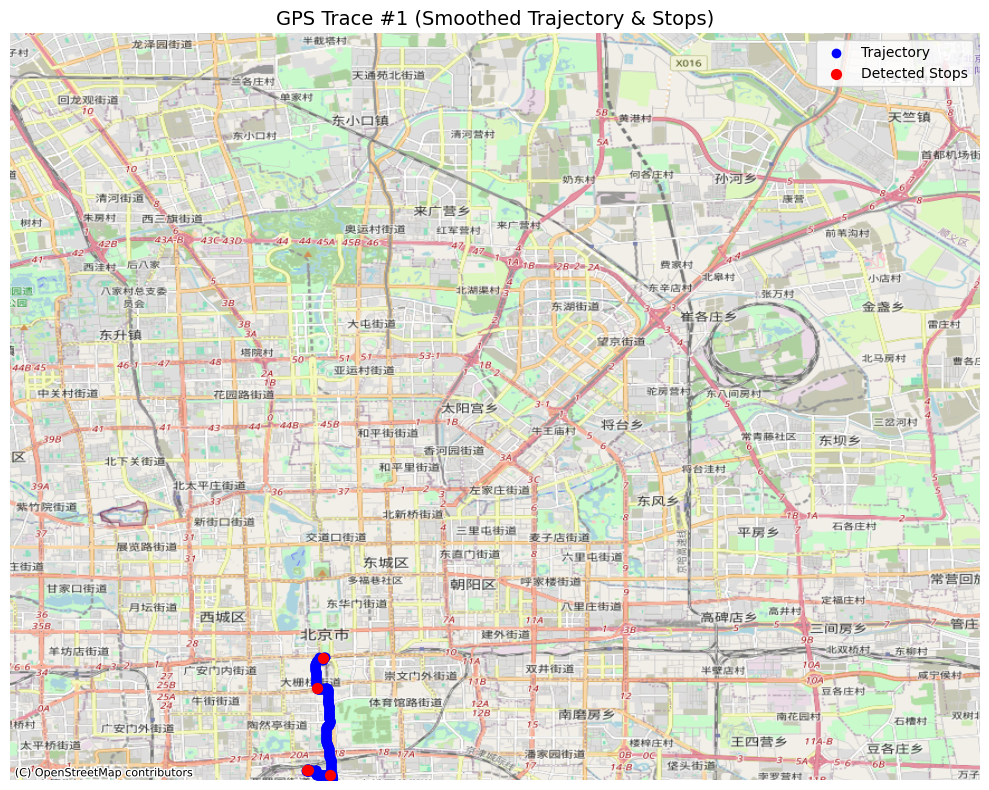

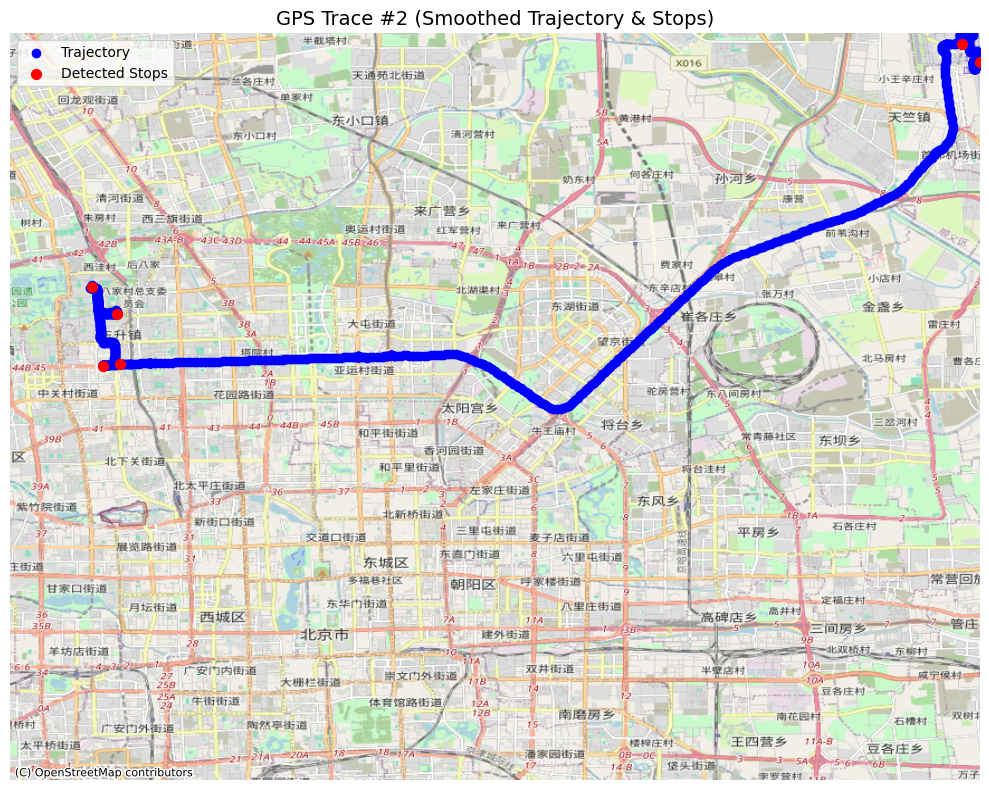

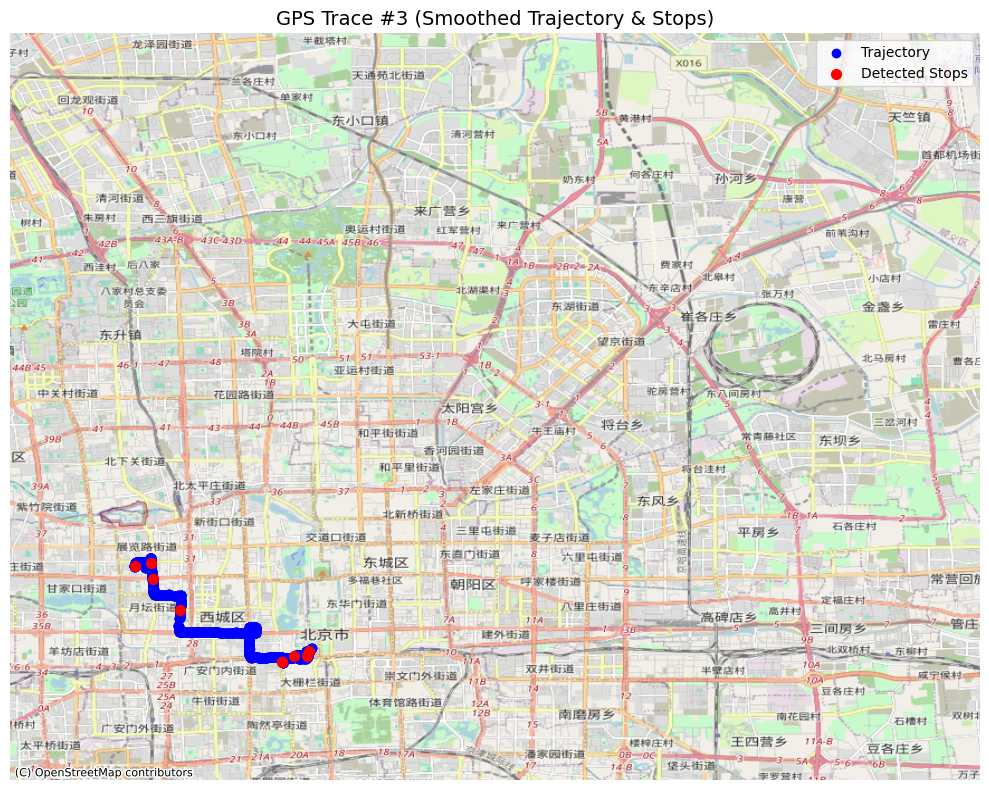

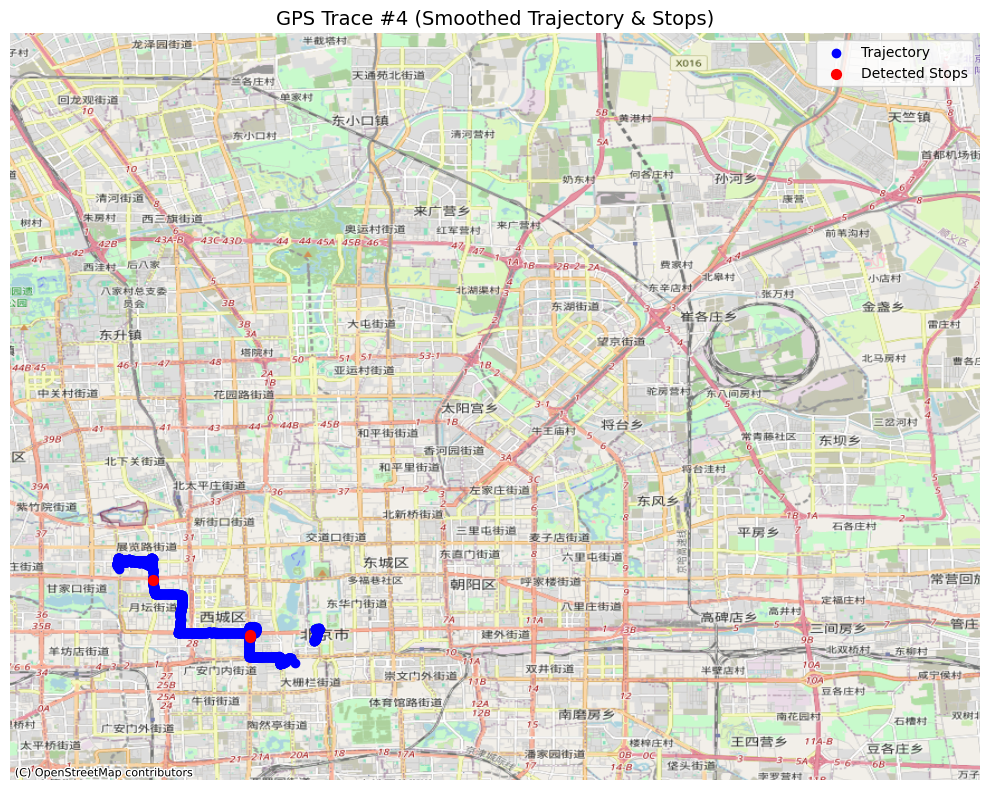

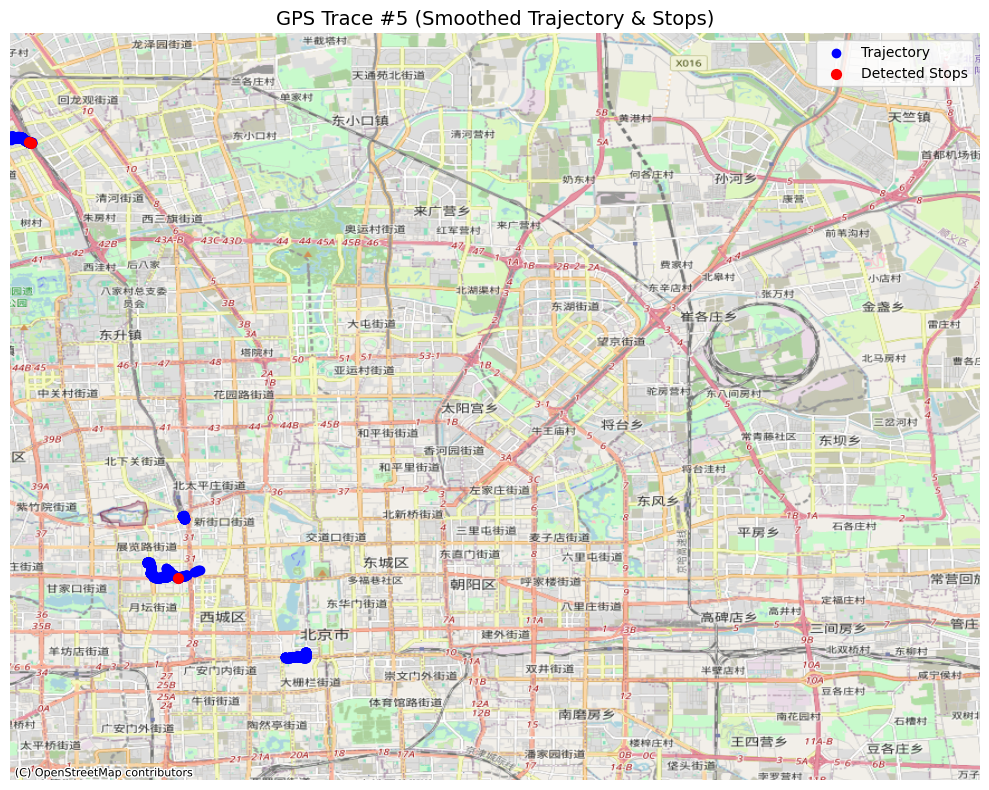

In [13]:

def plot_traces_with_stops_rb(gdf, stops_df=None, output_folder="./plots", display_inline=False):
    """
    Plot each GPS trace separately using smoothed coordinates with the same global scale and zoom,
    and overlay the detected stops (if provided). The plots can either be displayed inline or saved
    to disk based on the display_inline flag.
    
    Parameters:
      gdf (GeoDataFrame): A preprocessed GeoDataFrame containing at least the following columns:
                          - 'trace_number'
                          - 'geometry' (which should contain the smoothed coordinates)
                          - (and other columns as needed)
      stops_df (DataFrame, optional): A DataFrame containing stops data. It should contain at least:
                          - 'trace_number'
                          - 'lon' and 'lat' (the stop coordinates in EPSG:4326).
      output_folder (str): Folder where the plots will be saved (if display_inline is False).
      display_inline (bool): If True, display the plots inline; if False, save each plot to a file.
    
    Returns:
      If display_inline is False: List[str] of file paths for the saved plots.
      If display_inline is True: None.
    """
    # If not displaying inline, ensure the output folder exists.
    if not display_inline:
        os.makedirs(output_folder, exist_ok=True)
    
    # Reproject the entire GeoDataFrame to Web Mercator for basemap compatibility.
    gdf_proj = gdf.to_crs(epsg=3857)
    
    # Compute overall bounds from the full dataset (used to force the same zoom/scale for all plots).
    minx, miny, maxx, maxy = gdf_proj.total_bounds
    
    saved_files = []
    
    # Loop over each trace
    for trace_number, group in gdf_proj.groupby('trace_number'):
        fig, ax = plt.subplots(figsize=(10, 8))
        
        # Plot the trajectory for this trace
        ax.scatter(group.geometry.x, group.geometry.y, color='blue', label='Trajectory')
        
        # Plot stops for this trace.
        if stops_df is not None and 'trace_number' in stops_df.columns:
            stops_group = stops_df[stops_df['trace_number'] == trace_number]
            if not stops_group.empty:
                # Create a GeoDataFrame from stops data, reproject to EPSG:3857.
                stops_geo = gpd.GeoDataFrame(
                    stops_group,
                    geometry=gpd.points_from_xy(stops_group.lon, stops_group.lat),
                    crs="EPSG:4326"
                ).to_crs(epsg=3857)
                ax.scatter(stops_geo.geometry.x, stops_geo.geometry.y, color='red', s=50, label='Detected Stops')
        
        # Set the same global axis limits for every plot.
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)
        
        # Add basemap (using OpenStreetMap).
        ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
        
        # Titles, labels, and legend.
        ax.set_title(f'GPS Trace #{trace_number} (Smoothed Trajectory & Stops)', fontsize=14)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        ax.legend()
        ax.set_axis_off()  # Optionally hide the axes for a cleaner look
        
        plt.tight_layout()
        if display_inline:
            plt.show()
            plt.close(fig)
        else:
            output_path = os.path.join(output_folder, f"trace_{trace_number}.png")
            plt.savefig(output_path, dpi=300)
            plt.close(fig)
            saved_files.append(output_path)
    
    if not display_inline:
        return saved_files
    else:
        return None

# Usage
# Display plots inline:
plot_traces_with_stops_rb(final_gdf, stops_df, display_inline=True)

# Save plots to a folder and get a list of saved file paths)
#saved_plot_paths = plot_traces_with_stops_rb(final_gdf, stops_df, output_folder="./plots", display_inline=False)
#print("Saved plot files:", saved_plot_paths)


# DB SCAN APPOACH

### Stop Detection Using DBSCAN Clustering

To detect stop events, we apply the DBSCAN algorithm to each GPS trace individually using spatial proximity alone (no temporal dimension). The clustering is performed using the haversine distance, allowing us to account for the curvature of the Earth.

**Method Highlights**:
- Coordinates are grouped into clusters based on spatial proximity, using a configurable radius (eps_m).
- Clustering is applied per `device_id` and `trace_number` to ensure traces remain independent.
- Only clusters with at least `min_samples` points and a total duration exceeding `min_stop_duration` seconds are retained as stops.

For each detected stop, we compute aggregated features such as:
- Time span (`start_time`, `end_time`, `duration_seconds`)
- Mean location (`mean_latitude`, `mean_longitude`)
- Stop compactness (`max_radius`) and movement (`travel_distance`)
- Dynamic features (`avg_speed`, `avg_acceleration`, if available)

Finally, to ensure quality, we filter out any stop clusters with a spatial spread (`max_radius`) above 150 meters. This helps exclude overly dispersed or ambiguous stop patterns.

In [14]:

def compute_stop_clusters_dbscan(gdf, eps_m=30, min_samples=4, min_stop_duration=120):
    """
    Clusters GPS points into stops using plain DBSCAN (spatial clustering) and computes aggregated
    stop statistics for each cluster.

    Parameters:
      gdf (GeoDataFrame): Input GeoDataFrame with GPS data. Required columns include:
                          - 'ts': Timestamps (datetime)
                          - 'smooth_lat' and 'smooth_lon': Smoothed coordinates (in degrees)
                          - 'device_id': Device identifier
                          - 'trace_number': Identifier of the journey/trace
                          - (Optionally) 'speed_m_s' and 'acceleration_m_s2'
      eps_m (float): Spatial DBSCAN epsilon in meters.
      min_samples (int): Minimum number of points required to form a cluster.
      min_stop_duration (float): Minimum stop duration (in seconds) for a cluster to be kept.
      
    Returns:
      stop_clusters (DataFrame): Aggregated stop statistics; one row per cluster meeting the duration threshold.
      gdf (GeoDataFrame): The input GeoDataFrame updated with a new column 'dbscan_label' that contains 
                          the DBSCAN cluster labels (-1 indicates noise).
    """
    # Work on a copy of the DataFrame.
    gdf = gdf.copy()
    
    # We'll perform clustering per device and trace, so define a function.
    def cluster_trace(group):
        # For DBSCAN with the haversine metric, we need to convert latitude and longitude to radians.
        coords = np.radians(group[['smooth_lat', 'smooth_lon']].values)
        # Convert eps in meters to radians: eps_rad = eps_m / Earth's radius (≈6371000 m)
        eps_rad = eps_m / 6371000.0
        db = DBSCAN(eps=eps_rad, min_samples=min_samples, metric='haversine')
        labels = db.fit_predict(coords)
        group = group.copy()  # In case group is a view.
        group['dbscan_label'] = labels
        return group
    
    # Run DBSCAN separately for each device and trace.
    gdf = gdf.groupby(['device_id', 'trace_number'], group_keys=False).apply(cluster_trace)
    
    # Filter out noise points (-1).
    clustered_data = gdf[gdf['dbscan_label'] != -1].copy()
    
    def compute_cluster_stats(cluster):
        """
        Compute aggregated stop statistics for a given cluster.
        Returns a Series with:
          - start_time, end_time, duration_seconds,
          - avg_speed, avg_acceleration,
          - mean_latitude, mean_longitude (centroid),
          - max_radius (maximum distance from centroid),
          - travel_distance (distance between first and last point),
          - num_points (count)
        """
        # Convert the group to a plain DataFrame.
        df_cluster = pd.DataFrame(cluster)
        # Sort points by timestamp.
        df_sorted = df_cluster.sort_values('ts')
        start_time = df_sorted['ts'].iloc[0]
        end_time = df_sorted['ts'].iloc[-1]
        duration = (end_time - start_time).total_seconds()
        
        # Average speed and acceleration
        avg_speed = df_sorted['speed_m_s'].mean() if 'speed_m_s' in df_sorted.columns else np.nan
        avg_acceleration = df_sorted['acceleration_m_s2'].mean() if 'acceleration_m_s2' in df_sorted.columns else np.nan
        
        # Compute the centroid 
        mean_lat = df_sorted['smooth_lat'].mean()
        mean_lon = df_sorted['smooth_lon'].mean()
        centroid = (mean_lat, mean_lon)
        
        # Maximum radius: maximum geodesic distance from centroid.
        distances = df_sorted.apply(
            lambda row: geodesic((row['smooth_lat'], row['smooth_lon']), centroid).meters,
            axis=1
        )
        max_radius = distances.max()
        
        # Travel distance: distance between first and last point.
        first_coords = (df_sorted['smooth_lat'].iloc[0], df_sorted['smooth_lon'].iloc[0])
        last_coords  = (df_sorted['smooth_lat'].iloc[-1], df_sorted['smooth_lon'].iloc[-1])
        travel_distance = geodesic(first_coords, last_coords).meters
        
        num_points = len(df_sorted)
        
        return pd.Series({
            'start_time': start_time,
            'end_time': end_time,
            'duration_seconds': duration,
            'avg_speed': avg_speed,
            'avg_acceleration': avg_acceleration,
            'mean_latitude': mean_lat,
            'mean_longitude': mean_lon,
            'max_radius': max_radius,
            'travel_distance': travel_distance,
            'num_points': num_points
        })

    # Group by device_id, trace_number, and the DBSCAN cluster, and compute aggregated statistics.
    cluster_stats = clustered_data.groupby(['device_id', 'trace_number', 'dbscan_label']) \
                                    .apply(compute_cluster_stats) \
                                    .reset_index()

    # Filter to keep only clusters (stops) with a duration above the threshold.
    stop_clusters = cluster_stats[cluster_stats['duration_seconds'] >= min_stop_duration]
    
    return stop_clusters, gdf

# Usage 
stop_clusters, gdf = compute_stop_clusters_dbscan(final_gdf, eps_m=5, min_samples=4, min_stop_duration=60)
print("DBSCAN-Based Stops:")

stop_clusters = stop_clusters[stop_clusters.max_radius <150]
stop_clusters.head()

/var/folders/02/f4zvv9ps5hl4fw2wd6d985pc0000gn/T/ipykernel_37270/1265236233.py:38: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  gdf = gdf.groupby(['device_id', 'trace_number'], group_keys=False).apply(cluster_trace)


DBSCAN-Based Stops:


/var/folders/02/f4zvv9ps5hl4fw2wd6d985pc0000gn/T/ipykernel_37270/1265236233.py:100: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(compute_cluster_stats) \


,device_id,trace_number,dbscan_label,start_time,end_time,duration_seconds,avg_speed,avg_acceleration,mean_latitude,mean_longitude,max_radius,travel_distance,num_points
2,0,2,2,2009-06-29 07:05:30+00:00,2009-06-29 07:06:53+00:00,83.0,0.227750,-0.022133,40.074193,116.592589,4.501291,7.860154,21
6,0,2,6,2009-06-29 07:17:00+00:00,2009-06-29 07:30:25+00:00,805.0,0.935812,0.125219,40.079493,116.587036,9.215972,4.256013,13
11,0,2,11,2009-06-29 08:04:45+00:00,2009-06-29 08:06:55+00:00,130.0,0.427159,0.020765,39.984636,116.323113,17.069412,18.884185,31
13,0,2,13,2009-06-29 08:19:30+00:00,2009-06-29 10:57:42+00:00,9492.0,0.705110,0.034500,40.007653,116.319655,6.353695,9.477884,7
14,0,2,14,2009-06-29 11:04:27+00:00,2009-06-29 11:06:12+00:00,105.0,0.467998,-0.001796,39.999847,116.327336,13.531905,20.985880,26


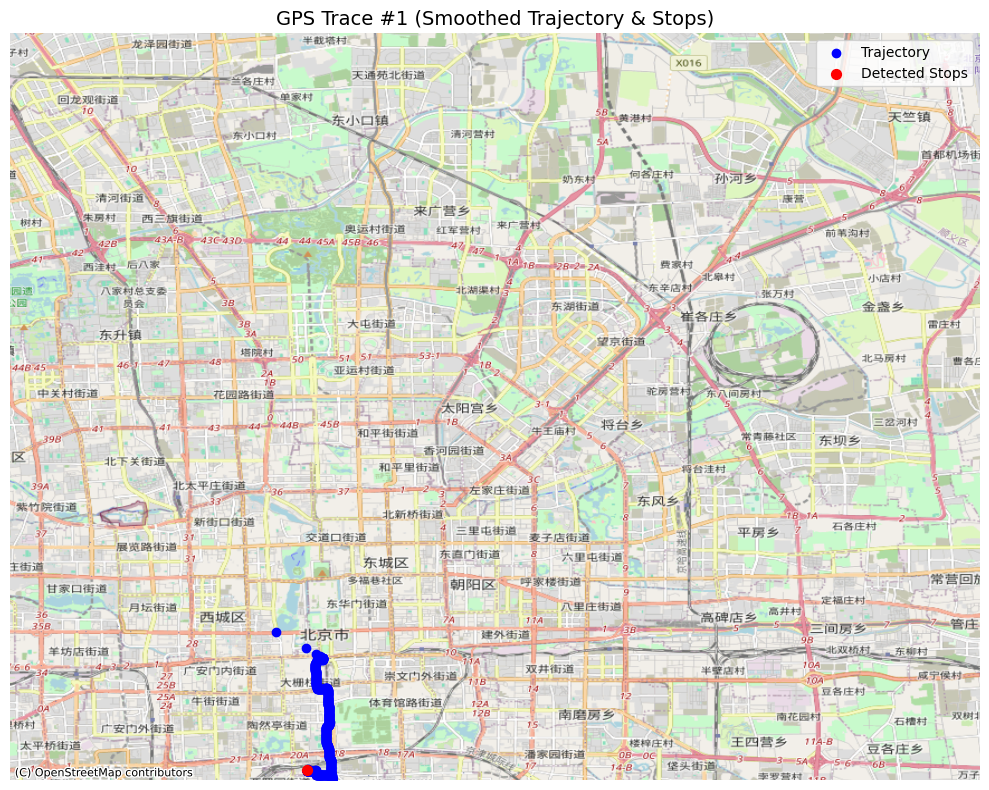

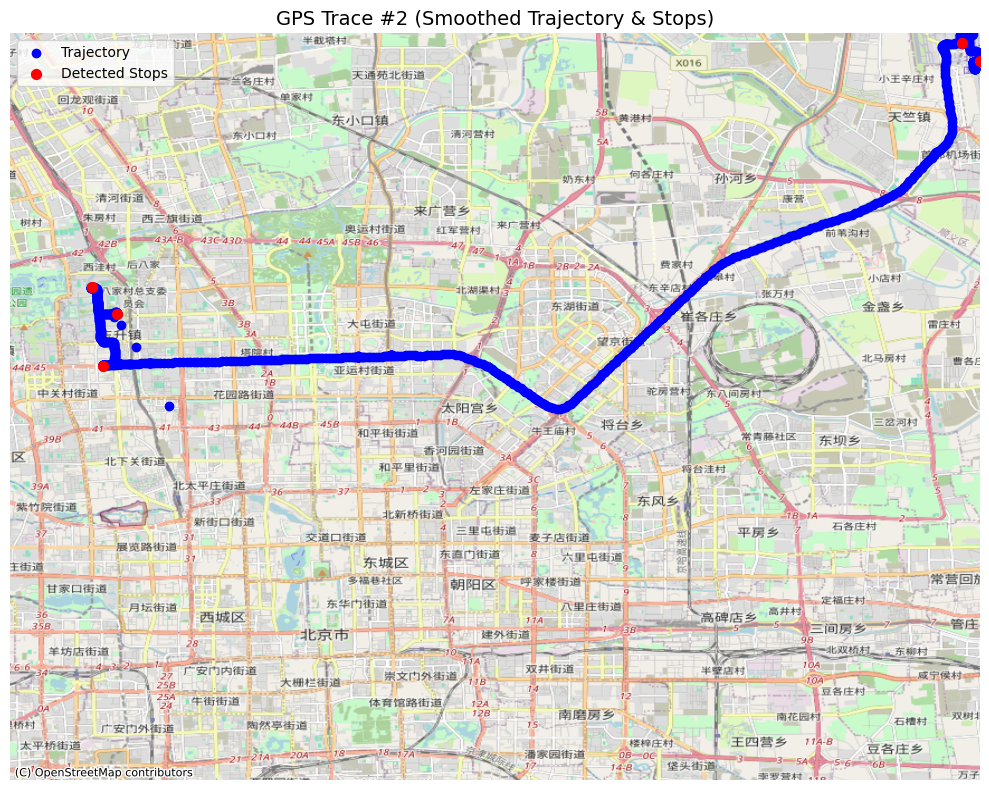

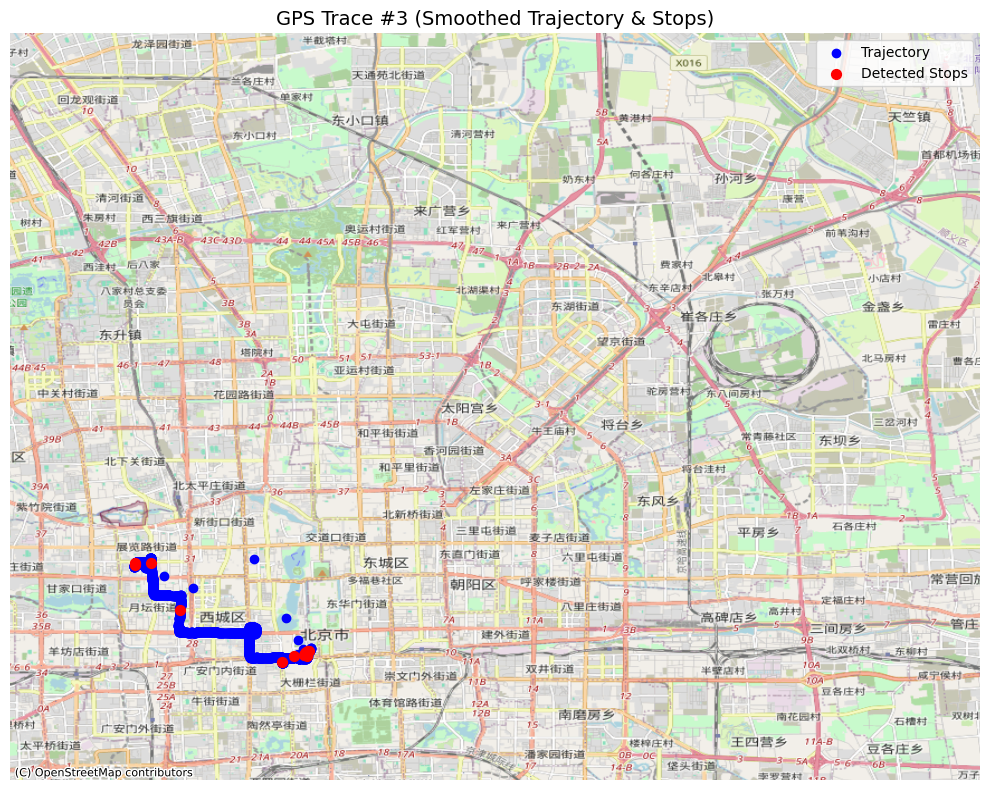

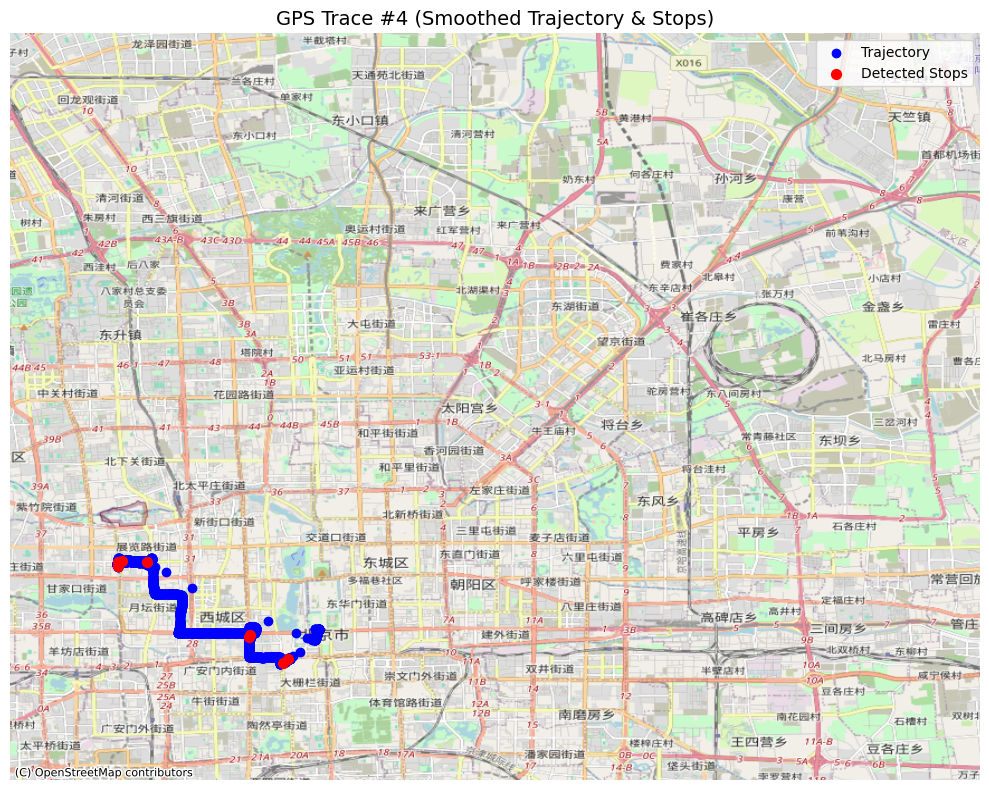

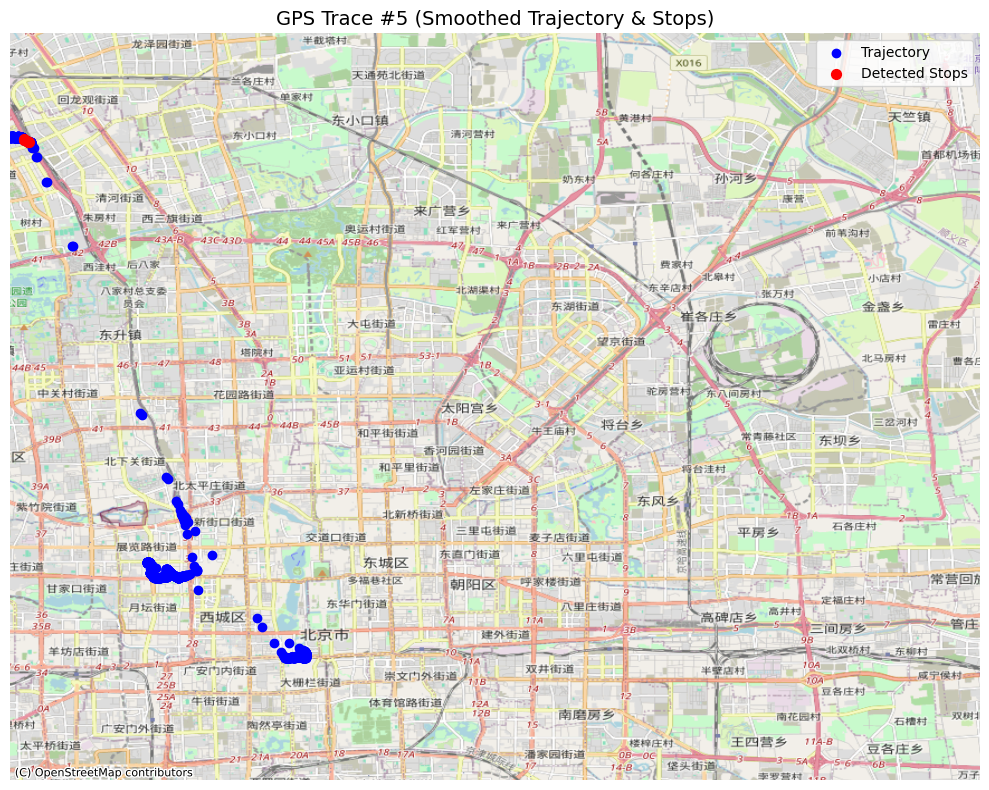

In [15]:
def plot_traces_with_stops_ml(gdf, stop_clusters=None, mode="inline", output_folder="./plots"):
    """
    Plot each GPS trace separately using smoothed coordinates with the same global scale and zoom,
    and overlay detected stops (if provided).

    Parameters:
      gdf (GeoDataFrame): A preprocessed GeoDataFrame containing at least the following columns:
                          - 'trace_number'
                          - 'smooth_lon' and 'smooth_lat' (to create the geometry)
                          (Other columns as needed.)
      stop_clusters (DataFrame, optional): A DataFrame containing stop data with at least:
                          - 'trace_number'
                          - 'mean_longitude' and 'mean_latitude'
      mode (str): Either "inline" (default) to display plots in the notebook,
                  or "save" to save the plots to files.
      output_folder (str): Folder where the plots will be saved (if mode is "save").

    Returns:
      If mode == "save", returns a list of file paths for the saved plots; otherwise, returns None.
    """
    # Create a working copy.
    data = gdf.copy()
    
    # Update the geometry column to use the smoothed coordinates.
    data['geometry'] = data.apply(lambda row: Point(row['smooth_lon'], row['smooth_lat']), axis=1)
    data = gpd.GeoDataFrame(data, geometry='geometry', crs="EPSG:4326")
    
    # Reproject the entire GeoDataFrame to Web Mercator for basemap compatibility.
    data_proj = data.to_crs(epsg=3857)
    
    # Compute global bounds from the full dataset to enforce the same zoom/scale.
    minx, miny, maxx, maxy = data_proj.total_bounds
    
    # If stop_clusters is provided, create a GeoDataFrame and project it.
    if stop_clusters is not None and 'trace_number' in stop_clusters.columns:
        stops_proj = gpd.GeoDataFrame(
            stop_clusters,
            geometry=gpd.points_from_xy(stop_clusters['mean_longitude'], stop_clusters['mean_latitude']),
            crs="EPSG:4326"
        ).to_crs(epsg=3857)
    else:
        stops_proj = None

    saved_files = []  # For saving mode.
    
    # Loop over each trace.
    for trace_number, group in data_proj.groupby('trace_number'):
        fig, ax = plt.subplots(figsize=(10, 8))
        
        # Plot the trajectory 
        ax.scatter(group.geometry.x, group.geometry.y, color='blue', label='Trajectory')
        
        # plot stops for this trace
        if stops_proj is not None:
            trace_stops = stops_proj[stops_proj['trace_number'] == trace_number]
            if not trace_stops.empty:
                ax.scatter(trace_stops.geometry.x, trace_stops.geometry.y,
                           color='red', s=50, label='Detected Stops')
        
        # Set global axis limits 
        ax.set_xlim(minx, maxx)
        ax.set_ylim(miny, maxy)
        
        # Add a basemap.
        ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
        
        # Configure title, labels, legend.
        ax.set_title(f'GPS Trace #{trace_number} (Smoothed Trajectory & Stops)', fontsize=14)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        ax.legend()
        ax.set_axis_off()  # Optionally hide the axes for a cleaner look.
        
        plt.tight_layout()
        
        if mode == "save":
            # Ensure the output folder exists.
            os.makedirs(output_folder, exist_ok=True)
            output_path = os.path.join(output_folder, f"trace_{trace_number}.png")
            plt.savefig(output_path, dpi=300)
            plt.close(fig)
            saved_files.append(output_path)
        else:
            plt.show()
            plt.close(fig)
    
    if mode == "save":
        return saved_files
    else:
        return None

# Usage
plot_traces_with_stops_ml(gdf, stop_clusters, mode="inline")
# Save plots to a folder:
#saved_paths = plot_traces_with_stops_ml(final_gdf, stop_clusters=None, mode="save", output_folder="./plots")
#print("Saved plot files:", saved_paths)


# API

### FastAPI Endpoint: CSV Upload and Stop Detection

This FastAPI service provides an interface for uploading a CSV file containing raw GPS traces. Upon receiving the file, the service performs the following steps:

#### Preprocessing
- Reads the uploaded CSV file.
- Converts the WKT geometry column into usable geometric objects.
- Constructs a GeoDataFrame and extracts latitude and longitude values.
- Sorts the data chronologically within each trace.

#### Feature Engineering
- Computes spatial and temporal features including:
  - Distance between consecutive points
  - Time differences
  - Instantaneous speed and acceleration
- Optionally applies a Kalman filter to smooth the coordinates.

#### Stop Detection
The service uses two approaches to detect stops:

1. **Rule-Based Method**  
   Identifies stops when a vehicle remains within a defined radius for a minimum duration.

2. **Clustering with DBSCAN**  
   Identifies spatial clusters of low-movement points and computes stop statistics, filtered by duration and cluster compactness.

#### Output
- Saves stop information from both methods into separate CSV files.
- Generates trajectory plots with overlaid stops, saved to disk.
- Returns a structured JSON response with the paths to the saved outputs.


In [83]:
nest_asyncio.apply()

app = FastAPI()


@app.post("/upload_csv/")
async def upload_csv(file: UploadFile = File(...)):
    """
    Accepts a CSV file containing raw GPS trace data, converts it into a GeoDataFrame,
    computes GPS features (with optional Kalman smoothing), identifies stops, saves the
    stops DataFrame as a CSV, and returns basic summary statistics along with the file path.
    
    Expected CSV columns:
      - 'ts': Timestamp
      - 'geom_wkt': WKT string of geometry (e.g. "POINT (lon lat)")
      - 'device_id': GPS device identifier
      - 'trace_number': Identifier for the trace/journey
    """
    try:
        # Check that the uploaded file is a CSV.
        if not file.filename.endswith('.csv'):
            raise HTTPException(status_code=400, detail="Please upload a CSV file.")
        
        # Read the CSV file into a Pandas DataFrame.
        contents = await file.read()
        df = pd.read_csv(io.StringIO(contents.decode("utf-8")))
        
        # Preprocessing:
        # Convert the timestamp column.
        df['ts'] = pd.to_datetime(df['ts'])
        # Convert geom_wkt to geometry objects.
        df['geometry'] = df['geom_wkt'].apply(wkt.loads)
        # Build a GeoDataFrame (CRS: EPSG:4326).
        gdf = gpd.GeoDataFrame(df, geometry='geometry', crs='EPSG:4326')
        # Sort by device_id, trace_number, and timestamp.
        gdf = gdf.sort_values(['device_id', 'trace_number', 'ts']).reset_index(drop=True)
        # Extract raw latitude and longitude.
        gdf['latitude'] = gdf.geometry.apply(lambda geom: geom.y)
        gdf['longitude'] = gdf.geometry.apply(lambda geom: geom.x)
        
        # Compute additional GPS features.
        final_gdf = compute_gps_features(gdf, use_smoothing=True)
        
        #########RULE-BASED OUTPUT#########
        # Identify stops in the processed GeoDataFrame.
        stops_df = identify_stops(final_gdf)       
        
        # Save the stops DataFrame to a CSV file.
        rb_output_filename = "rule_based_stops_output.csv"
        # save to a dedicated folder.
        rb_output_folder = "./output/rule_based_stops_output"
        os.makedirs(rb_output_folder, exist_ok=True)
        rb_output_filepath = os.path.join(rb_output_folder, rb_output_filename)
        stops_df.to_csv(rb_output_filepath, index=False)
        rb_saved_plot_paths = plot_traces_with_stops_rb(final_gdf, stops_df, output_folder=rb_output_folder, display_inline=False)
        
        #########DBSCAN OUTPUT#########

        stop_clusters, gdf = compute_stop_clusters_dbscan(final_gdf, eps_m=5, min_samples=4, min_stop_duration=60)
        stop_clusters = stop_clusters[stop_clusters.max_radius <150]

        # Save the stops DataFrame to a CSV file.
        dbscan_output_filename = "dbscan_stops_output.csv"
        #save to a dedicated folder.
        dbscan_output_folder = "./output/dbscan_stops_output"
        os.makedirs(dbscan_output_folder, exist_ok=True)
        dbscan_output_filepath = os.path.join(dbscan_output_folder, dbscan_output_filename)
        stop_clusters.to_csv(dbscan_output_filepath, index=False)
        dbscan_saved_plot_paths = plot_traces_with_stops_ml(final_gdf, stop_clusters=None, mode="save", output_folder=dbscan_output_folder)
        
        result = {
            "rule_based_output_path": rb_output_filepath,
            "rule_based_plot_path": rb_saved_plot_paths,
            "dbscan_output_path": dbscan_output_filepath,
            "dbscan_plot_path": dbscan_saved_plot_paths
        }
        return result
        
    except Exception as e:
        raise HTTPException(status_code=500, detail=str(e))
        
# Run the app in a background thread so  notebook remains interactiveS
def run_app():
    uvicorn.run(app, host="127.0.0.1", port=8008, log_level="info")

threading.Thread(target=run_app, daemon=True).start()

print("FastAPI server is running on http://127.0.0.1:8004")


FastAPI server is running on http://127.0.0.1:8004


INFO:     Started server process [33419]
INFO:     Waiting for application startup.
INFO:     Application startup complete.
ERROR:    [Errno 48] error while attempting to bind on address ('127.0.0.1', 8008): address already in use
INFO:     Waiting for application shutdown.
INFO:     Application shutdown complete.


In [84]:


# URL of your FastAPI endpoint.
url = "http://127.0.0.1:8008/upload_csv/"

# Open the CSV file in binary mode.
with open("gps_traces.csv", "rb") as f:
    # The key 'file' must match the parameter name in your API endpoint.
    files = {"file": f}
    response = requests.post(url, files=files)

# Print the JSON response returned by the API.
print(response.json())


{'rule_based_output_path': './output/rule_based_stops_output/rule_based_stops_output.csv', 'rule_based_plot_path': ['./output/rule_based_stops_output/trace_1.png', './output/rule_based_stops_output/trace_2.png', './output/rule_based_stops_output/trace_3.png', './output/rule_based_stops_output/trace_4.png', './output/rule_based_stops_output/trace_5.png'], 'dbscan_output_path': './output/dbscan_stops_output/dbscan_stops_output.csv', 'dbscan_plot_path': ['./output/dbscan_stops_output/trace_1.png', './output/dbscan_stops_output/trace_2.png', './output/dbscan_stops_output/trace_3.png', './output/dbscan_stops_output/trace_4.png', './output/dbscan_stops_output/trace_5.png']}


# Detect Patterns, Behaviors 

# Behavior Detection in GPS Traces Using ST-DBSCAN

ST-DBSCAN is a powerful clustering algorithm that combines both spatial and temporal proximity to group GPS points. By considering when and where points occur together, it allows us to go beyond simple stop detection and uncover meaningful patterns in movement behavior.

**Why Use ST-DBSCAN for Behavior Detection?**

- **Time-Aware Clustering:**  
  Unlike traditional spatial clustering, ST-DBSCAN takes into account the timing of GPS points. 

- **Revealing Movement Patterns:**  
  Once clusters are identified, we can analyze the points within them to detect behavioral signals—such as slowing down, erratic paths, or frequent changes in direction.

- **Rich Aggregated Insights:**  
  By computing features like average speed, median acceleration, and spatial dispersion (max radius), we can characterize each cluster. For example, a low-speed cluster with high directional changes might indicate complex navigation or congested traffic.

In summary, ST-DBSCAN provides more than just stop detection—it enables deeper analysis of movement patterns and behaviors hidden within GPS traces.


In [44]:
from geopy.distance import geodesic
import pandas as pd
import numpy as np
from st_dbscan import ST_DBSCAN  # Ensure that you have the ST-DBSCAN library installed

def compute_stop_clusters_stdbscan(gdf, eps_m=200, eps_t=120, min_samples=4, min_stop_duration=0):
    """
    Clusters GPS points into stops using ST-DBSCAN (spatio-temporal clustering) and computes aggregated
    stop statistics for each cluster.
    
    Parameters:
      gdf (GeoDataFrame): Input GeoDataFrame with GPS data. Required columns include:
                          - 'ts': Timestamps (datetime)
                          - 'smooth_lat' and 'smooth_lon': Smoothed coordinates (in degrees)
                          - 'device_id': Device identifier
                          - 'trace_number': Identifier of the journey/trace
                          - (Optionally) 'speed_m_s' and 'acceleration_m_s2'
      eps_m (float): Spatial ST-DBSCAN epsilon in meters.
      eps_t (float): Temporal ST-DBSCAN epsilon in seconds.
      min_samples (int): Minimum number of points required to form a cluster.
      min_stop_duration (float): Minimum stop duration (in seconds) for a cluster to be kept.
      
    Returns:
      stop_clusters (DataFrame): Aggregated stop statistics; one row per cluster meeting the duration threshold.
      gdf (GeoDataFrame): The input GeoDataFrame updated with a new column 'st_dbscan_label' that contains 
                          the ST-DBSCAN cluster labels (-1 indicates noise).
    """
    # Work on a copy of the DataFrame.
    gdf = gdf.copy()
    
    def cluster_trace(group):
        group = group.copy()
        # Ensure 'ts' is datetime and convert to epoch seconds.
        group['ts'] = pd.to_datetime(group['ts'])
        group['timestamp_sec'] = group['ts'].astype(np.int64) // 10**9
        
        # Prepare features: spatial coordinates and temporal value.
        # (Depending on the library, you might need to adjust the scaling of the temporal dimension)
        X = group[['smooth_lat', 'smooth_lon', 'timestamp_sec']].values
        
        # Initialize ST-DBSCAN.
        # eps1 corresponds to the spatial threshold (in meters) and
        # eps2 to the temporal threshold (in seconds).
        st_dbscan = ST_DBSCAN(eps1=eps_m, eps2=eps_t, min_samples=min_samples)
        
        # Fit the model and then retrieve cluster labels. 
        # (Some implementations store the labels in an attribute like `labels_`.)
        st_dbscan.fit(X)
        labels = st_dbscan.labels
        group['st_dbscan_label'] = labels
        
        return group

    # Run ST-DBSCAN separately for each device and trace.
    gdf = gdf.groupby(['device_id', 'trace_number'], group_keys=False).apply(cluster_trace)
    
    # Filter out noise points (label == -1)
    clustered_data = gdf[gdf['st_dbscan_label'] != -1].copy()
    
    def compute_cluster_stats(cluster):
        """
        Compute aggregated stop statistics for a given cluster.
        Returns a Series with:
          - start_time, end_time, duration_seconds,
          - avg_speed, avg_acceleration,
          - mean_latitude, mean_longitude (centroid),
          - max_radius (maximum distance from centroid),
          - travel_distance (distance between first and last point),
          - num_points (count)
        """
        # Sort points by timestamp.
        df_sorted = cluster.sort_values('ts')
        start_time = df_sorted['ts'].iloc[0]
        end_time = df_sorted['ts'].iloc[-1]
        duration = (end_time - start_time).total_seconds()
        
        # Compute average speed and acceleration if the columns exist.
        avg_speed = df_sorted['speed_m_s'].mean() if 'speed_m_s' in df_sorted.columns else np.nan
        med_acceleration = df_sorted['acceleration_m_s2'].median() if 'acceleration_m_s2' in df_sorted.columns else np.nan
        
        # Compute the centroid.
        mean_lat = df_sorted['smooth_lat'].mean()
        mean_lon = df_sorted['smooth_lon'].mean()
        centroid = (mean_lat, mean_lon)
        
        # Compute maximum radius: maximum geodesic distance from the centroid.
        distances = df_sorted.apply(
            lambda row: geodesic((row['smooth_lat'], row['smooth_lon']), centroid).meters,
            axis=1
        )
        max_radius = distances.max()
        
        # Compute travel distance: distance between first and last point.
        first_coords = (df_sorted['smooth_lat'].iloc[0], df_sorted['smooth_lon'].iloc[0])
        last_coords  = (df_sorted['smooth_lat'].iloc[-1], df_sorted['smooth_lon'].iloc[-1])
        travel_distance = geodesic(first_coords, last_coords).meters
        
        num_points = len(df_sorted)
        
        return pd.Series({
            'start_time': start_time,
            'end_time': end_time,
            'duration_seconds': duration,
            'avg_speed': avg_speed,
            'med_acceleration': med_acceleration,
            'mean_latitude': mean_lat,
            'mean_longitude': mean_lon,
            'max_radius': max_radius,
            'travel_distance': travel_distance,
            'num_points': num_points
        })

    # Aggregate cluster statistics by grouping on device, trace, and cluster label.
    cluster_stats = clustered_data.groupby(['device_id', 'trace_number', 'st_dbscan_label']) \
                                    .apply(compute_cluster_stats) \
                                    .reset_index()
    
    # Filter clusters to retain only those with a duration exceeding the threshold.
    stop_clusters = cluster_stats[cluster_stats['duration_seconds'] >= min_stop_duration]
    
    return stop_clusters, gdf

# Usage Example:
stop_clusters, gdf = compute_stop_clusters_stdbscan(final_gdf, eps_m=100, eps_t=120, min_samples=4, min_stop_duration=0)
# print("ST-DBSCAN Based Stops:")
#stop_clusters = stop_clusters[stop_clusters.max_radius < 150]
stop_clusters


/var/folders/02/f4zvv9ps5hl4fw2wd6d985pc0000gn/T/ipykernel_37270/4168808548.py:55: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  gdf = gdf.groupby(['device_id', 'trace_number'], group_keys=False).apply(cluster_trace)
/var/folders/02/f4zvv9ps5hl4fw2wd6d985pc0000gn/T/ipykernel_37270/4168808548.py:115: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(compute_cluster_stats) \


,device_id,trace_number,st_dbscan_label,start_time,end_time,duration_seconds,avg_speed,med_acceleration,mean_latitude,mean_longitude,max_radius,travel_distance,num_points
0,0,2,0,2009-06-29 07:02:25+00:00,2009-06-29 07:13:55+00:00,690.0,3.125725,0.001080,40.077484,116.589895,618.552798,964.063424,149
1,0,2,1,2009-06-29 07:29:35+00:00,2009-06-29 08:20:15+00:00,3040.0,10.803691,0.002983,40.005535,116.421873,16319.782354,24167.284075,619
2,0,2,2,2009-06-29 10:57:17+00:00,2009-06-29 11:06:52+00:00,575.0,2.613771,0.002994,40.002323,116.323580,682.835901,1021.305445,120
3,0,2,3,2009-06-29 11:09:12+00:00,2009-06-29 11:10:07+00:00,55.0,48.856306,1.060230,39.997176,116.327994,894.527302,1257.445022,5
4,2,3,0,2009-02-04 04:32:53+00:00,2009-02-04 04:35:03+00:00,130.0,81.437482,-0.037288,39.901197,116.385146,3225.023635,3337.213710,42
5,2,3,1,2009-02-04 10:03:21+00:00,2009-02-04 10:17:31+00:00,850.0,1.784164,-0.003912,39.899185,116.385228,235.579065,71.613924,240
6,2,3,2,2009-02-04 10:20:07+00:00,2009-02-04 11:20:12+00:00,3605.0,5.206219,0.002126,39.910531,116.356830,2788.632334,3699.219742,1528
7,2,4,0,2009-03-10 10:36:45+00:00,2009-03-10 10:37:49+00:00,64.0,31.125124,0.055339,39.904820,116.388137,1332.393527,1335.685515,53
8,2,4,1,2009-03-10 10:40:45+00:00,2009-03-10 10:40:51+00:00,6.0,9.217000,-0.075523,39.906877,116.388384,27.939861,39.841226,5
9,2,4,2,2009-03-10 10:43:20+00:00,2009-03-10 10:44:22+00:00,62.0,6.628658,-0.065780,39.906777,116.389380,323.194728,331.151396,37


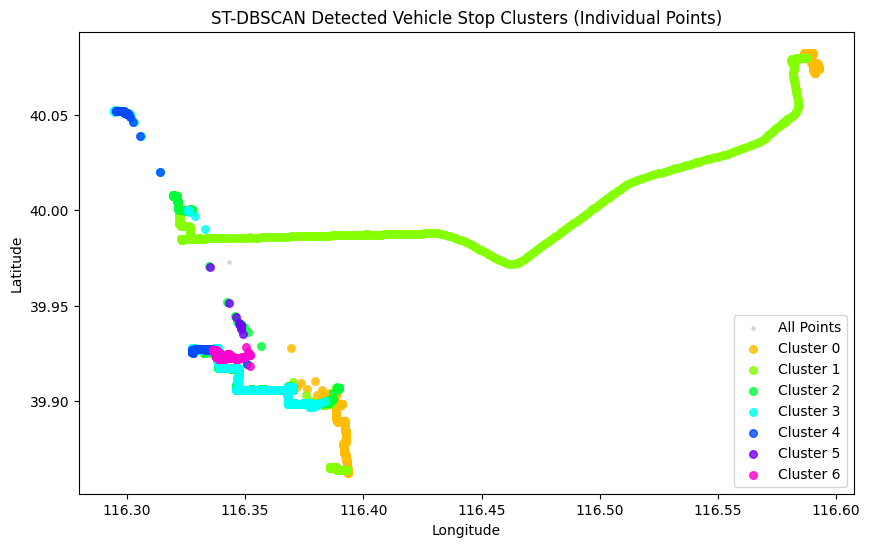

In [45]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))

# Plot all points (here using your spatial columns; adjust names if needed).
plt.scatter(gdf['smooth_lon'], gdf['smooth_lat'], s=5, c='lightgray', label='All Points')

# Filter points that are part of a cluster (not noise).
clustered_points = gdf[gdf['st_dbscan_label'] != -1].copy()

# Get unique clusters.
unique_clusters = sorted(clustered_points['st_dbscan_label'].unique())

# Create a distinct color for each cluster.
colors = sns.color_palette("hsv", len(unique_clusters))

# Plot each cluster with its own color.
for cluster, color in zip(unique_clusters, colors):
    cluster_data = clustered_points[clustered_points['st_dbscan_label'] == cluster]
    plt.scatter(cluster_data['smooth_lon'], cluster_data['smooth_lat'],
                s=30, c=[color], label=f'Cluster {cluster}', alpha=0.8)

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('ST-DBSCAN Detected Vehicle Stop Clusters (Individual Points)')
plt.legend()
plt.show()
